# Version 2

## ISIC 2024 - Skin Cancer Detection with 3D-TBP
### OverView
In this challenge you are differentiating benign from malignant cases. For each image (isic_id) you are assigning the probability (target) ranging [0, 1] that the case is malignant.
### Dataset
* train-image/ - image files for the training set (provided for train only)
* train-image.hdf5 - training image data contained in a single hdf5 file, with the isic_id as key
* train-metadata.csv - metadata for the training set
* test-image.hdf5 - test image data contained in a single hdf5 file, with the isic_id as key. This contains 3 test examples to ensure your inference pipeline works correctly. When the submitted notebook is rerun, this file is swapped with the full hidden test set, which contains approximately 500k images.
* test-metadata.csv - metadata for the test subset
* sample_submission.csv - a sample submission file in the correct format

### Importing Libraries 🗃️

In [2]:
import numpy as np
import pandas as pd
import os
import matplotlib.pyplot as plt
import tensorflow as tf
from PIL import Image
import random 


### Data Analysis and Visulization 🔬

In [2]:
train_file = pd.read_csv("train-metadata.csv")
train_file.head()

C:\Users\M_ros\AppData\Local\Temp\ipykernel_27192\4212521792.py:1: DtypeWarning: Columns (51,52) have mixed types. Specify dtype option on import or set low_memory=False.
  train_file = pd.read_csv("train-metadata.csv")


,isic_id,target,patient_id,age_approx,sex,anatom_site_general,clin_size_long_diam_mm,image_type,tbp_tile_type,tbp_lv_A,...,lesion_id,iddx_full,iddx_1,iddx_2,iddx_3,iddx_4,iddx_5,mel_mitotic_index,mel_thick_mm,tbp_lv_dnn_lesion_confidence
0,ISIC_0015670,0,IP_1235828,60.0,male,lower extremity,3.04,TBP tile: close-up,3D: white,20.244422,...,NaN,Benign,Benign,NaN,NaN,NaN,NaN,NaN,NaN,97.517282
1,ISIC_0015845,0,IP_8170065,60.0,male,head/neck,1.10,TBP tile: close-up,3D: white,31.712570,...,IL_6727506,Benign,Benign,NaN,NaN,NaN,NaN,NaN,NaN,3.141455
2,ISIC_0015864,0,IP_6724798,60.0,male,posterior torso,3.40,TBP tile: close-up,3D: XP,22.575830,...,NaN,Benign,Benign,NaN,NaN,NaN,NaN,NaN,NaN,99.804040
3,ISIC_0015902,0,IP_4111386,65.0,male,anterior torso,3.22,TBP tile: close-up,3D: XP,14.242329,...,NaN,Benign,Benign,NaN,NaN,NaN,NaN,NaN,NaN,99.989998
4,ISIC_0024200,0,IP_8313778,55.0,male,anterior torso,2.73,TBP tile: close-up,3D: white,24.725520,...,NaN,Benign,Benign,NaN,NaN,NaN,NaN,NaN,NaN,70.442510


In [3]:
train_file.shape

(401059, 55)

In [4]:
print("No of Target in the Dataset  ")
train_file['target'].value_counts()

No of Target in the Dataset  


target
0    400666
1       393
Name: count, dtype: int64

## Plotting Image 📈

In [5]:
image_dir = os.listdir('train-image/image')
print('No of Images we have -->',len(image_dir))

No of Images we have --> 401059


In [6]:
# taking 8 random positive and negative image
pos_img_file = random.sample(list(train_file.loc[train_file['target'] == 1]['isic_id']),8) 
print('Postive Image ID-->',pos_img_file)


neg_img_file = random.sample(list(train_file.loc[train_file['target'] == 0]['isic_id']),8) 
print('Negative Image ID-->',neg_img_file)

Postive Image ID--> ['ISIC_8717913', 'ISIC_1063394', 'ISIC_2581432', 'ISIC_0220459', 'ISIC_3813551', 'ISIC_7445958', 'ISIC_1262710', 'ISIC_4629159']
Negative Image ID--> ['ISIC_5506922', 'ISIC_1826235', 'ISIC_1927876', 'ISIC_4105527', 'ISIC_7587256', 'ISIC_4612138', 'ISIC_7866412', 'ISIC_5348875']


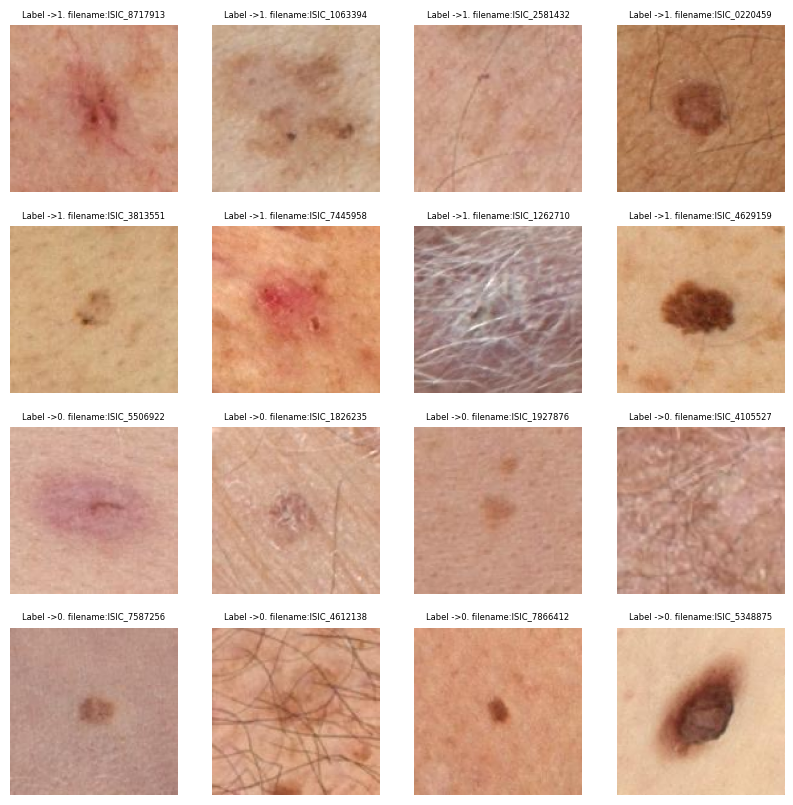

In [7]:
fig , axis = plt.subplots(nrows= 4 , ncols = 4 ,figsize=(10,10))

for ax , im , target in zip(axis.flatten(),pos_img_file+neg_img_file,[1]*8+[0]*8):
    img = Image.open('train-image/image/'+f'{im}.jpg')
    ax.imshow(img)
    ax.axis('off')
    ax.set_title(f'Label ->{target}. filename:{im}',fontsize= 6)


## Balacning the dataset ⚖️

In [8]:
images_paths = [] # list to store image_paths
images_labels = [] # list to store labels


pos_img_pahts = random.sample(list(train_file.loc[train_file['target'] == 1]['isic_id']),393)
neg_img_paths = random.sample(list(train_file.loc[train_file['target'] == 0]['isic_id']),393)


In [9]:
len(pos_img_pahts)

393

In [10]:
pol = []
negl = []
for i , k in zip(neg_img_paths,pos_img_pahts):
    pol.append(train_file.loc[train_file['isic_id'] == k]['target'].values[0])
    negl.append(train_file.loc[train_file['isic_id'] == i]['target'].values[0])


Storing them into main images and labels lists

In [11]:
images_paths = pos_img_pahts + neg_img_paths
images_labels = pol + negl

In [12]:
len(images_paths)
len(images_labels)

786

## Data Pre-Processing 📡

In [13]:
def load_and_preprocess_image(im_path, label):
    im_path = tf.strings.join(['train-image/image/', im_path, '.jpg'], separator='')
    image = tf.io.read_file(im_path)
    image = tf.image.decode_jpeg(image, channels=3)
    image = tf.image.resize(image, [64, 64])
    image = image / 255.0
    return image, label

# Create the dataset
dataset = tf.data.Dataset.from_tensor_slices((images_paths, images_labels))

# Shuffle the dataset
dataset = dataset.shuffle(buffer_size=len(images_paths), seed=42)

# Define the split ratio
validation_split = 0.2
dataset_size = len(images_paths)
validation_size = int(validation_split * dataset_size)
train_size = dataset_size - validation_size

# Split the dataset into training and validation sets
train_dataset = dataset.take(train_size)
validation_dataset = dataset.skip(train_size)


In [14]:
# Map the preprocessing function to both datasets
train_dataset = train_dataset.map(load_and_preprocess_image, num_parallel_calls=tf.data.experimental.AUTOTUNE)
validation_dataset = validation_dataset.map(load_and_preprocess_image, num_parallel_calls=tf.data.experimental.AUTOTUNE)

# Batch the datasets
batch_size = 5
train_dataset = train_dataset.batch(batch_size).prefetch(tf.data.experimental.AUTOTUNE)
validation_dataset = validation_dataset.batch(batch_size).prefetch(tf.data.experimental.AUTOTUNE)


## Building  Model 🧠 
### Using Transfer Learning on VGG16



In [15]:
from tensorflow.keras.layers import Conv2D, Dense, MaxPool2D,Flatten , Input
from tensorflow.keras import Model

from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy
from tensorflow.keras.models import Sequential

VGG16 Import

In [64]:
from keras.applications.vgg16 import VGG16

In [66]:
conv_base = VGG16(
    weights= 'imagenet',
    include_top= False,
    input_shape= (64,64,3)
)

In [68]:
conv_base.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 64, 64, 3)]       0         
                                                                 
 block1_conv1 (Conv2D)       (None, 64, 64, 64)        1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 64, 64, 64)        36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 32, 32, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 32, 32, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 32, 32, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 16, 16, 128)       0     

### Freezing the top layers of VGG16

In [73]:
conv_base.trainable = False

In [76]:
conv_base.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 64, 64, 3)]       0         
                                                                 
 block1_conv1 (Conv2D)       (None, 64, 64, 64)        1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 64, 64, 64)        36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 32, 32, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 32, 32, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 32, 32, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 16, 16, 128)       0     

In [93]:
inputs = Input(shape= (64,64,3)),
x = conv_base(inputs)
x = Flatten()(x)
x = Dense(256)(x)
outputs =  Dense(1,activation = 'sigmoid')(x)


model = Model(inputs,outputs)



In [94]:
model.compile(loss='BinaryCrossentropy',optimizer='rmsprop',metrics=['accuracy'])


In [95]:
model.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_5 (InputLayer)        [(None, 64, 64, 3)]       0         
                                                                 
 vgg16 (Functional)          (None, 2, 2, 512)         14714688  
                                                                 
 flatten_2 (Flatten)         (None, 2048)              0         
                                                                 
 dense_4 (Dense)             (None, 256)               524544    
                                                                 
 dense_5 (Dense)             (None, 1)                 257       
                                                                 
Total params: 15,239,489
Trainable params: 524,801
Non-trainable params: 14,714,688
_________________________________________________________________


In [96]:
history = model.fit(train_dataset,
                    validation_data = validation_dataset,
                    epochs = 20,
                    validation_steps = 20)

Epoch 1/20
126/126 [==============================] - 2s 11ms/step - loss: 1.3450 - accuracy: 0.5103 - val_loss: 1.1780 - val_accuracy: 0.5200
Epoch 2/20
126/126 [==============================] - 1s 8ms/step - loss: 0.8134 - accuracy: 0.6232 - val_loss: 0.5791 - val_accuracy: 0.6300
Epoch 3/20
126/126 [==============================] - 1s 8ms/step - loss: 0.6725 - accuracy: 0.6455 - val_loss: 0.7662 - val_accuracy: 0.5400
Epoch 4/20
126/126 [==============================] - 1s 8ms/step - loss: 0.6091 - accuracy: 0.6868 - val_loss: 0.5580 - val_accuracy: 0.6800
Epoch 5/20
126/126 [==============================] - 1s 8ms/step - loss: 0.5493 - accuracy: 0.7234 - val_loss: 0.5141 - val_accuracy: 0.7300
Epoch 6/20
126/126 [==============================] - 1s 8ms/step - loss: 0.5470 - accuracy: 0.7091 - val_loss: 0.4607 - val_accuracy: 0.7700
Epoch 7/20
126/126 [==============================] - 1s 8ms/step - loss: 0.5317 - accuracy: 0.7234 - val_loss: 0.5158 - val_accuracy: 0.7700
Epoch

### Graph Validation of VGG16

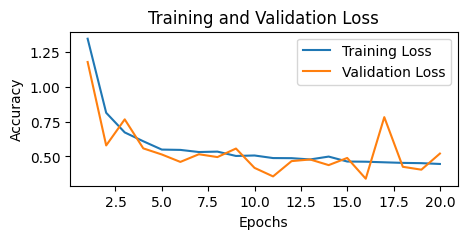

In [97]:

# Extract accuracy and validation accuracy
accuracy = history.history['loss']
val_accuracy = history.history['val_loss']

# Extract number of epochs
epochs = range(1, len(accuracy) + 1)

# Plot the training and validation accuracy
plt.figure(figsize=(5, 2))
plt.plot(epochs, accuracy, label='Training Loss')
plt.plot(epochs, val_accuracy, label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()


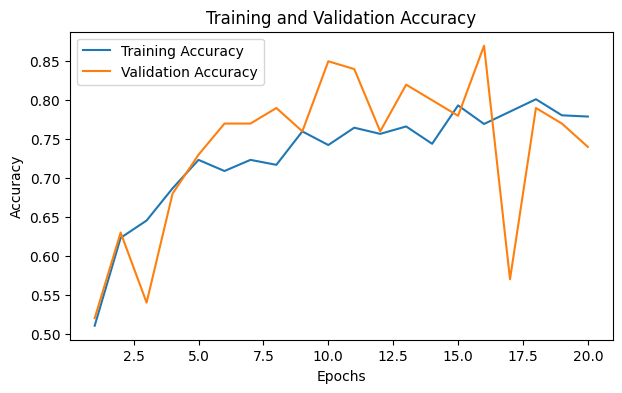

In [98]:
# Extract accuracy and validation accuracy
accuracy = history.history['accuracy']
val_accuracy = history.history['val_accuracy']

# Extract number of epochs
epochs = range(1, len(accuracy) + 1)

# Plot the training and validation accuracy
plt.figure(figsize=(7, 4))
plt.plot(epochs, accuracy, label='Training Accuracy')
plt.plot(epochs, val_accuracy, label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()


### Accuracy of the model

In [113]:
ta = history.history['accuracy'][-1] * 100
va = history.history['val_accuracy'][-1] * 100
print(f"Training Accuracy is {ta:.3f}%")
print(f'Validation Accuracy is {va:.3f}%')

Training Accuracy is 77.901%
Validation Accuracy is 74.000%


Saving Vgg16 model

In [99]:
model.save("Skin_VGG16_v1.h5")

testing on custom image

In [100]:
from tensorflow.keras.models import load_model
# Define the function to load and preprocess the custom image
def load_and_preprocess_custom_image(image_path):
    image = tf.io.read_file(image_path)
    image = tf.image.decode_jpeg(image, channels=3)
    image = tf.image.resize(image, [64, 64])
    image = image / 255.0
    return image

# Path to the custom image
custom_image_path = 'cq5dam.web.1280.1280.jpeg'
# Load and preprocess the custom image
cmodel = load_model('Skin_VGG16_v1.h5')
custom_image = load_and_preprocess_custom_image(custom_image_path)
custom_image = tf.expand_dims(custom_image, axis=0)  # Add batch dimension

# Predict using the trained model
prediction = cmodel.predict(custom_image)

# Print the prediction
print("Prediction for the custom image:", prediction)



1/1 [==============================] - 0s 102ms/step
Prediction for the custom image: [[0.7931143]]


### Fine Tunning the VGG16 by training some of its layer\

In [118]:
conv_base_vgg16_2 = VGG16(
    weights= 'imagenet',
    include_top= False,
    input_shape= (64,64,3)
)

making it trainable and then freezing some of its layers

block4_pool should be frozen, and the layers block5_conv1, block5_conv2, and block5_conv3
should be trainable

In [119]:
conv_base_vgg16_2.trainable = True

In [120]:
for layer in conv_base.layers[:-4]:
    layer.trainable = False

In [123]:
inputs = Input(shape= (64,64,3)),
x = conv_base_vgg16_2(inputs)
x = Flatten()(x)
x = Dense(256)(x)
outputs =  Dense(1,activation = 'sigmoid')(x)


model2 = Model(inputs,outputs)



In [122]:
model.summary()

Model: "model_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_7 (InputLayer)        [(None, 64, 64, 3)]       0         
                                                                 
 vgg16 (Functional)          (None, 2, 2, 512)         14714688  
                                                                 
 flatten_3 (Flatten)         (None, 2048)              0         
                                                                 
 dense_6 (Dense)             (None, 256)               524544    
                                                                 
 dense_7 (Dense)             (None, 1)                 257       
                                                                 
Total params: 15,239,489
Trainable params: 15,239,489
Non-trainable params: 0
_________________________________________________________________


In [135]:
model2.compile(optimizer='adam',loss='binary_crossentropy',metrics=['accuracy'])


In [136]:
history2 = model2.fit(train_dataset,
           validation_data = validation_dataset,
           epochs = 20,
           validation_steps = 20)

Epoch 1/20
126/126 [==============================] - 3s 18ms/step - loss: 0.6934 - accuracy: 0.5087 - val_loss: 0.6930 - val_accuracy: 0.5100
Epoch 2/20
126/126 [==============================] - 2s 15ms/step - loss: 0.6930 - accuracy: 0.5151 - val_loss: 0.6916 - val_accuracy: 0.5600
Epoch 3/20
126/126 [==============================] - 2s 15ms/step - loss: 0.6934 - accuracy: 0.4976 - val_loss: 0.6936 - val_accuracy: 0.4900
Epoch 4/20
126/126 [==============================] - 2s 15ms/step - loss: 0.6934 - accuracy: 0.4976 - val_loss: 0.6935 - val_accuracy: 0.4800
Epoch 5/20
126/126 [==============================] - 2s 15ms/step - loss: 0.6934 - accuracy: 0.4674 - val_loss: 0.6932 - val_accuracy: 0.4900
Epoch 6/20
126/126 [==============================] - 2s 15ms/step - loss: 0.6933 - accuracy: 0.4865 - val_loss: 0.6931 - val_accuracy: 0.5300
Epoch 7/20
126/126 [==============================] - 2s 15ms/step - loss: 0.6932 - accuracy: 0.5024 - val_loss: 0.6930 - val_accuracy: 0.5400

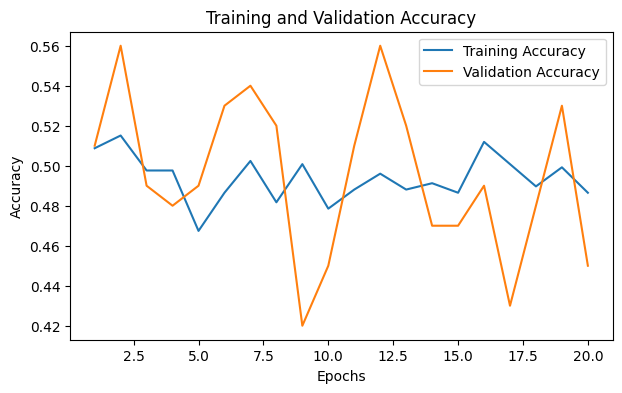

In [137]:
# Extract accuracy and validation accuracy
accuracy = history2.history['accuracy']
val_accuracy = history2.history['val_accuracy']

# Extract number of epochs
epochs = range(1, len(accuracy) + 1)

# Plot the training and validation accuracy
plt.figure(figsize=(7, 4))
plt.plot(epochs, accuracy, label='Training Accuracy')
plt.plot(epochs, val_accuracy, label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()


In [138]:
model2.save("vgg16finetune.h5")

building the model again 

## ResNet50V2

In [16]:
from keras.applications.resnet_v2 import ResNet50V2


In [24]:
conv_base_rest_net = ResNet50V2(
    weights= 'imagenet',
    include_top= False,
    input_shape= (64,64,3)
)

In [25]:
conv_base_rest_net.trainable =False

In [27]:
conv_base_rest_net.summary()

Model: "resnet50v2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 64, 64, 3)]  0           []                               
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 70, 70, 3)    0           ['input_3[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 32, 32, 64)   9472        ['conv1_pad[0][0]']              
                                                                                                  
 pool1_pad (ZeroPadding2D)      (None, 34, 34, 64)   0           ['conv1_conv[0][0]']             
                                                                                         

In [29]:
inputs = Input(shape= (64,64,3)),
x = conv_base_rest_net(inputs)
x = Flatten()(x)
x = Dense(256)(x)
outputs =  Dense(1,activation = 'sigmoid')(x)


model3 = Model(inputs,outputs)



In [35]:
model3.compile(loss='binary_crossentropy',optimizer='rmsprop',metrics=['accuracy'])

In [36]:
history_res = model3.fit(train_dataset,
           validation_data=validation_dataset,
           epochs= 10,
           validation_steps = 5)

Epoch 1/10
126/126 [==============================] - 4s 16ms/step - loss: 0.1000 - accuracy: 0.9746 - val_loss: 0.0010 - val_accuracy: 1.0000
Epoch 2/10
126/126 [==============================] - 1s 11ms/step - loss: 0.0579 - accuracy: 0.9793 - val_loss: 0.0024 - val_accuracy: 1.0000
Epoch 3/10
126/126 [==============================] - 1s 10ms/step - loss: 0.0400 - accuracy: 0.9889 - val_loss: 6.1538e-04 - val_accuracy: 1.0000
Epoch 4/10
126/126 [==============================] - 1s 9ms/step - loss: 0.0222 - accuracy: 0.9952 - val_loss: 0.0294 - val_accuracy: 0.9600
Epoch 5/10
126/126 [==============================] - 1s 10ms/step - loss: 0.0299 - accuracy: 0.9889 - val_loss: 7.3010e-06 - val_accuracy: 1.0000
Epoch 6/10
126/126 [==============================] - 1s 10ms/step - loss: 0.0263 - accuracy: 0.9873 - val_loss: 0.0077 - val_accuracy: 1.0000
Epoch 7/10
126/126 [==============================] - 1s 10ms/step - loss: 0.0175 - accuracy: 0.9952 - val_loss: 3.5801e-04 - val_accur

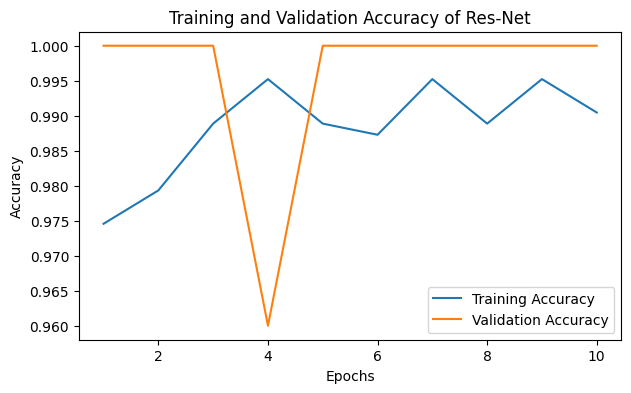

In [37]:
# Extract accuracy and validation accuracy
accuracy = history_res.history['accuracy']
val_accuracy = history_res.history['val_accuracy']

# Extract number of epochs
epochs = range(1, len(accuracy) + 1)

# Plot the training and validation accuracy
plt.figure(figsize=(7, 4))
plt.plot(epochs, accuracy, label='Training Accuracy')
plt.plot(epochs, val_accuracy, label='Validation Accuracy')
plt.title('Training and Validation Accuracy of Res-Net')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()


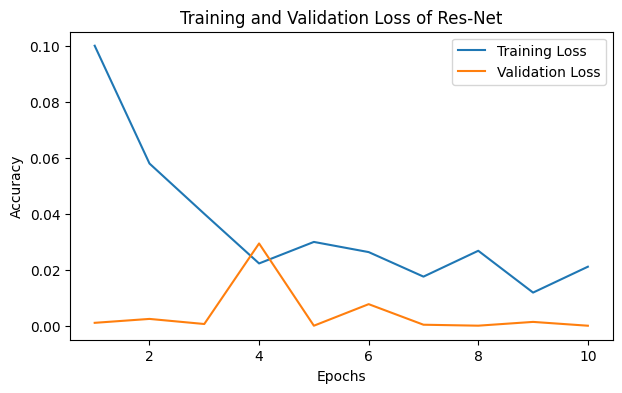

In [38]:
# Extract accuracy and validation accuracy
accuracy = history_res.history['loss']
val_accuracy = history_res.history['val_loss']

# Extract number of epochs
epochs = range(1, len(accuracy) + 1)

# Plot the training and validation accuracy
plt.figure(figsize=(7, 4))
plt.plot(epochs, accuracy, label='Training Loss')
plt.plot(epochs, val_accuracy, label='Validation Loss')
plt.title('Training and Validation Loss of Res-Net')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()


In [39]:
model3.save("skin-renet.h5")

# testing on the train images just to know the time out

Efficient Code

In [5]:
import os
import tensorflow as tf
from tensorflow.keras.models import load_model

# Define a function to load and preprocess a batch of images
def load_and_preprocess_images(image_paths):
    images = []
    for im_path in image_paths:
        image = load_and_preprocess_custom_image(im_path)
        images.append(image)
    images = tf.stack(images)  # Stack images into a single tensor
    return images

# Path to the custom images directory
image_dir = "train-image/image/"
image_paths = [os.path.join(image_dir, i) for i in tm]

# Load the model once
cmodel = load_model('skin-renet.h5')

# Define batch size
batch_size = 32  # Adjust batch size based on your memory capacity

# Predict in batches
predictions = []
for start in range(0, len(image_paths), batch_size):
    end = min(start + batch_size, len(image_paths))
    batch_paths = image_paths[start:end]
    batch_images = load_and_preprocess_images(batch_paths)
    batch_predictions = cmodel.predict(batch_images)
    predictions.extend(batch_predictions)

# Print predictions for the batch
for i, prediction in enumerate(predictions):
    print(f"Prediction for image {tm[i]}:", prediction)


1/1 [==============================] - 1s 697ms/step
Prediction for image ISIC_0015670.jpg: [8.391333e-11]
Prediction for image ISIC_0015845.jpg: [5.895853e-09]
Prediction for image ISIC_0015864.jpg: [0.92928463]
Prediction for image ISIC_0015902.jpg: [5.3679323e-05]
Prediction for image ISIC_0024200.jpg: [2.4193672e-09]
Prediction for image ISIC_0035502.jpg: [0.9999999]
Prediction for image ISIC_0051648.jpg: [1.784527e-18]
Prediction for image ISIC_0051665.jpg: [4.947175e-07]
Prediction for image ISIC_0051710.jpg: [1.593918e-13]
Prediction for image ISIC_0051758.jpg: [9.371591e-10]
Prediction for image ISIC_0051812.jpg: [2.4868662e-06]
Prediction for image ISIC_0051822.jpg: [0.20229316]
Prediction for image ISIC_0051896.jpg: [1.7550883e-15]
Prediction for image ISIC_0051897.jpg: [6.770362e-17]
Prediction for image ISIC_0051958.jpg: [1.1304686e-09]
Prediction for image ISIC_0051983.jpg: [7.37437e-19]
Prediction for image ISIC_0052003.jpg: [5.6423875e-07]
Prediction for image ISIC_00520

## Testing again with hdf5 file

In [1]:
import os
import h5py
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import load_model
from PIL import Image
import cv2
import io

# Load the model once
cmodel = load_model('skin-renet.h5')

# Load the HDF5 file
file_path = 'train-image.hdf5'  # Replace with your HDF5 file path
image_ids = []
predictions = []
images = []

# Function to preprocess images
def preprocess_image(image):
    img_resized = cv2.resize(image, (64, 64))
    img_resized = img_resized.astype('float32') / 255.0
    return img_resized

with h5py.File(file_path, 'r') as hdf:
    # Get the number of test images
    num_test_images = len(hdf.keys())
    
    # Set batch size based on the number of test images
    if num_test_images <= 3:
        batch_size = 3
    else:
        batch_size = 150
    
    # Access each dataset and process the data
    for key in hdf.keys():
        binary_data = hdf[key][...]
        image_ids.append(key)
        
        # Convert binary data to image
        image = Image.open(io.BytesIO(binary_data))
        image = np.array(image)  # Convert PIL Image to numpy array
        preprocessed_image = preprocess_image(image)
        images.append(preprocessed_image)
        
        # If the batch size is reached, make predictions
        if len(images) == batch_size:
            images_np = np.array(images)
            batch_predictions = cmodel.predict(images_np)
            predictions.extend([f'{pred[0]:.6f}' for pred in batch_predictions])
            images = []  # Reset the list for the next batch

    # Process remaining images if any
    if images:
        images_np = np.array(images)
        batch_predictions = cmodel.predict(images_np)
        predictions.extend([f'{pred[0]:.6f}' for pred in batch_predictions])

# Print predictions
for image_id, prediction in zip(image_ids, predictions):
    print(f"Prediction for image {image_id}: {prediction}")


4/4 [==============================] - 0s 33ms/step
Prediction for image ISIC_0015670: 0.000000
Prediction for image ISIC_0015845: 0.000000
Prediction for image ISIC_0015864: 0.971622
Prediction for image ISIC_0015902: 0.000022
Prediction for image ISIC_0024200: 0.000000
Prediction for image ISIC_0035502: 1.000000
Prediction for image ISIC_0051648: 0.000000
Prediction for image ISIC_0051665: 0.000002
Prediction for image ISIC_0051710: 0.000000
Prediction for image ISIC_0051758: 0.000000
Prediction for image ISIC_0051812: 0.000002
Prediction for image ISIC_0051822: 0.537216
Prediction for image ISIC_0051896: 0.000000
Prediction for image ISIC_0051897: 0.000000
Prediction for image ISIC_0051958: 0.000000
Prediction for image ISIC_0051983: 0.000000
Prediction for image ISIC_0052003: 0.000011
Prediction for image ISIC_0052004: 0.000000
Prediction for image ISIC_0052026: 0.000002
Prediction for image ISIC_0052042: 0.906284
Prediction for image ISIC_0052068: 0.000000
Prediction for image ISI

In [3]:
import pandas as pd
d = pd.DataFrame({'isic_id':image_id,'target':predictions})
d

,isic_id,target
0,ISIC_9999967,0.000000
1,ISIC_9999967,0.000000
2,ISIC_9999967,0.971622
3,ISIC_9999967,0.000022
4,ISIC_9999967,0.000000
...,...,...
401054,ISIC_9999967,0.999178
401055,ISIC_9999967,0.000000
401056,ISIC_9999967,1.000000
401057,ISIC_9999967,0.000000


In [5]:
d.to_csv('test.csv',index=False)